In [2]:
import copy
import enum
import json

import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [3]:
results = json.load(open("results.json"))

In [4]:
class Direction(enum.Enum):
    BIGGER_BETTER = 1
    SMALLER_BETTER = 2
    NOTHING_BETTER = 3

    def __lt__(self, other):
        return self.value < other.value

    def __gt__(self, other):
        return self.value > other.value

    def __eq__(self, other):
        return self.value == other.value

In [5]:
direction_better = {
    "AreaUnderTheCurve $A$": Direction.BIGGER_BETTER,
    "AverageDegree $A_{Deg}$": Direction.NOTHING_BETTER,
    "AverageDistance $A_{Dis}$": Direction.NOTHING_BETTER,
    "CumulativeRegret $CR$": Direction.SMALLER_BETTER,
    "FeasibilityRate $FR$": Direction.BIGGER_BETTER,
    "MeanConvergenceRateMetric $\\overline{\\kappa}$": Direction.BIGGER_BETTER,
    "NormalizedAreaUnderTheCurve $A_{\\text{norm}}$": Direction.BIGGER_BETTER,
    "Precision $PR$": Direction.BIGGER_BETTER,
    "Recall $RC$": Direction.BIGGER_BETTER,
    "SimpleRegret $SR$": Direction.SMALLER_BETTER,
    "UncertaintyCurveArea $A_{\\text{uncertainty}}$": Direction.SMALLER_BETTER,
    "PointsBetterRandomRatio $\\overline{\\rho_{BRR}}$": Direction.BIGGER_BETTER,
    "KuiperMetric $D_{\\text{Kuiper}}$": Direction.NOTHING_BETTER,
    "KolmogorovSmirnovMetric $D_{\\text{KS}}$": Direction.NOTHING_BETTER,
    "MeanSlope $\\overline{f_\\Delta}$": Direction.BIGGER_BETTER,
    "MedianGlobalBestConvergenceValue $\\alpha^*$": Direction.BIGGER_BETTER,
    "MedianPointToPointConvergenceValue $\\alpha$": Direction.BIGGER_BETTER,
    "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$": Direction.BIGGER_BETTER,
    "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$": Direction.SMALLER_BETTER,
    "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$": Direction.NOTHING_BETTER,
    "Point Position Score $\\overline{\\eta}$": Direction.NOTHING_BETTER,
        "Variance Point Score $\\eta^{\\sigma}$": Direction.NOTHING_BETTER,

    "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$": Direction.BIGGER_BETTER,
    "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$": Direction.SMALLER_BETTER,
    "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$": Direction.NOTHING_BETTER,
    "MeanVariance $\\overline{f_\\sigma}$": Direction.SMALLER_BETTER,
}

In [6]:
for key in direction_better.keys():
    print(f"\\item[{key}:] ")

\item[AreaUnderTheCurve $A$:] 
\item[AverageDegree $A_{Deg}$:] 
\item[AverageDistance $A_{Dis}$:] 
\item[CumulativeRegret $CR$:] 
\item[FeasibilityRate $FR$:] 
\item[MeanConvergenceRateMetric $\overline{\kappa}$:] 
\item[NormalizedAreaUnderTheCurve $A_{\text{norm}}$:] 
\item[Precision $PR$:] 
\item[Recall $RC$:] 
\item[SimpleRegret $SR$:] 
\item[UncertaintyCurveArea $A_{\text{uncertainty}}$:] 
\item[PointsBetterRandomRatio $\overline{\rho_{BRR}}$:] 
\item[KuiperMetric $D_{\text{Kuiper}}$:] 
\item[KolmogorovSmirnovMetric $D_{\text{KS}}$:] 
\item[MeanSlope $\overline{f_\Delta}$:] 
\item[MedianGlobalBestConvergenceValue $\alpha^*$:] 
\item[MedianPointToPointConvergenceValue $\alpha$:] 
\item[PointsBetterPreviousRatio $\overline{\rho_{BPR}}$:] 
\item[PointsWorsePreviousRatio $\overline{\rho_{WPR}}$:] 
\item[PointsEqualPreviousRatio $\overline{\rho_{EPR}}$:] 
\item[Point Position Score $\overline{\eta}$:] 
\item[Variance Point Score $\eta^{\sigma}$:] 
\item[PointsVarianceBetterPreviousRatio

In [7]:
taskmap = {
    "default_direct_arylation": "a chemical example with default settings",
    "direct_arylation": "a chemical example with consistent settings",
    "holdertable": "Holder Table",
    "levy": "Levy with noise",
    "michalewicz": "Michalewicz",
    "michalewicz100": "Michalewicz with 100 Monte Carlo samples",
    "nn_levy": "Levy without noise",
    "photo_pce_10": "a material science example",
    "arrow_micha": "Michalewicz",
    "michalewicz_ucb": "Michalewicz with UCB",
}

In [8]:
result_lists_over_versions_src = {}

for task, task_dict in results.items():
    if task not in result_lists_over_versions_src:
        result_lists_over_versions_src[task] = {}
    for version, version_dict in task_dict.items():
        for case_row, case_dict in version_dict.items():
            if case_row not in result_lists_over_versions_src[task]:
                result_lists_over_versions_src[task][case_row] = {}
            if "Metrics" not in result_lists_over_versions_src[task][case_row]:
                result_lists_over_versions_src[task][case_row]["Metrics"] = []
            result_lists_over_versions_src[task][case_row]["Metrics"].append(
                version.replace("0.0", "0.") if version != "0.10.0" else version
            )
            for metric, metric_value in case_dict.items():
                if case_row == "Iterative best":
                    continue
                if metric not in result_lists_over_versions_src[task][case_row]:
                    result_lists_over_versions_src[task][case_row][metric] = []
                result_lists_over_versions_src[task][case_row][metric].append(
                    float(metric_value)
                )

In [9]:
task = "michalewicz_ucb"
if task in result_lists_over_versions_src:
    metrics_dict = result_lists_over_versions_src[task]
    plt.rcParams.update({"font.size": 36})
    df_cumbest = pd.DataFrame.from_dict(metrics_dict["Cumulative best"])

    df_cumbest = df_cumbest.drop("Metrics", axis=1)
    # Create a heatmap with numbered labels
    metric_mapping = {metric: f"M{i+1}" for i, metric in enumerate(df_cumbest.columns)}
    df_cumbest_renamed = df_cumbest.rename(columns=metric_mapping)

    spearman_corr_cumbest = df_cumbest_renamed.corr(method="spearman")
    # spearman_corr_iter = df_iter_renamed.corr(method="spearman")

    fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(80, 40))
    sns.heatmap(
        spearman_corr_cumbest,
        annot=True,
        cmap="plasma",
        center=0,
        ax=axes,
        vmin=-1,
        vmax=1,
    )

    # Add legend
    legend_text = "".join(
        [
            f"{v}: {k} -- " if v not in ("M6", "M11") else f"{v}: {k}\n"
            for i, (k, v) in enumerate(metric_mapping.items())
        ]
    )
    legend_text = legend_text[:-4]
    plt.figtext(
        0.45,
        -0.05,
        legend_text,
        ha="center",
        fontsize=45,
        bbox={"facecolor": "white", "alpha": 0.5, "pad": 20},
        horizontalalignment="center",
        verticalalignment="center",
        transform=plt.gcf().transFigure,
    )
    plt.suptitle(f"Benchmark: {taskmap[task]}", fontsize=64)
    plt.tight_layout()
    plt.savefig(
        f"out/correlation_heatmap_{task}.svg",
        format="svg",
        dpi=300,
        bbox_inches="tight",
    )

In [10]:
result_lists_over_versions_src_copy = copy.deepcopy(result_lists_over_versions_src)
for task, task_dict in result_lists_over_versions_src_copy.items():
    for case_row, case_dict in task_dict.items():
        if case_row == "Iterative best":
            continue
        if (
            "Point Position Score $\\overline{\\eta}$"
            not in result_lists_over_versions_src[task][case_row]
        ):
            result_lists_over_versions_src[task][case_row][
                "Point Position Score $\\overline{\\eta}$"
            ] = []
        if (
            "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$"
            in result_lists_over_versions_src[task][case_row]
        ):
            better_prev = result_lists_over_versions_src[task][case_row][
                "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$"
            ]
        else:
            better_prev = []

        if (
            "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$"
            in result_lists_over_versions_src[task][case_row]
        ):
            worse_prev = result_lists_over_versions_src[task][case_row][
                "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$"
            ]
        else:
            worse_prev = []

        if (
            "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$"
            in result_lists_over_versions_src[task][case_row]
        ):
            equal_prev = result_lists_over_versions_src[task][case_row][
                "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$"
            ]
        else:
            equal_prev = []
        # del result_lists_over_versions_src[task][case_row]E["PointsEqualPreviousRatio"]
        for better_value, equal_value, worse_value in zip(
            better_prev, equal_prev, worse_prev
        ):
            if better_value == -2 or equal_value == -2 or worse_value == -2:
                result_lists_over_versions_src[task][case_row][
                    "Point Position Score $\\overline{\\eta}$"
                ].append(float(-2))
                continue
            point_score = ((2 * better_value + equal_value) / (2)) - worse_value
            result_lists_over_versions_src[task][case_row][
                "Point Position Score $\\overline{\\eta}$"
            ].append(float(point_score))

In [11]:
result_lists_over_versions_src_copy = copy.deepcopy(result_lists_over_versions_src)
for task, task_dict in result_lists_over_versions_src_copy.items():
    for case_row, case_dict in task_dict.items():
        if case_row == "Iterative best":
            continue
        if (
            "Variance Point Score $\\eta^{\\sigma}$"
            not in result_lists_over_versions_src[task][case_row]
        ):
            result_lists_over_versions_src[task][case_row][
                "Variance Point Score $\\eta^{\\sigma}$"
            ] = []
        better_prev = result_lists_over_versions_src[task][case_row].get(
            "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$", []
        )
        worse_prev = result_lists_over_versions_src[task][case_row].get(
            "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$", []
        )
        equal_prev = result_lists_over_versions_src[task][case_row].get(
            "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$", []
        )
        for better_value, equal_value, worse_value in zip(
            better_prev, equal_prev, worse_prev
        ):
            if better_value == -2 or equal_value == -2 or worse_value == -2:
                result_lists_over_versions_src[task][case_row][
                    "Variance Point Score $\\eta^{\\sigma}$"
                ].append(float(-2))
                continue
            point_score = ((2 * better_value + equal_value) / (2)) - worse_value
            result_lists_over_versions_src[task][case_row][
                "Variance Point Score $\\eta^{\\sigma}$"
            ].append(float(point_score))


In [12]:
dfs = []

In [13]:
def mark_index(index):
    if index in direction_better:
        if direction_better[index] == Direction.BIGGER_BETTER:
            return f"\\textbf{{{index}}}"
        elif direction_better[index] == Direction.SMALLER_BETTER:
            return f"\\underline{{{index}}}"
    return index


print("\\chapter{Metric results and companions}")
print("\\label{ch:metric_appendix}")
print(
    f"""This appendix contains the metric results for the benchmarks of the different tasks. The results are presented in tables where the columns represent the different versions of the algorithm and the rows indicate the used metrics, respectively. The name of the metric is written in bold if a higher value is better and underlined if a lower value is better. If a value is better than the previous value, the cell is colored green, and if it is worse, it is colored red for the cases where a certain value direction is better or worse. If the metric is neither better with a higher nor lower value, the name is written in normal text. To express the value change of a metric, a small arrow is added which visualize the metric value change compared to the respective previouse version. For some measurements, a dataset to compare the results with was necessary. Those were compared with the predecessor software version. The first version could therefore not be compared with any other version, which is why the cell is marked with an "X".
    
    \\vspace{{1em}}
    For the calculation of the feasibility rate, the area where an experiment sample
was defined as feasible has been set explicitly depending on the benchmarking task, 
since the convergence diversity of the tasks highly varies. The following percentage values to calculate how much a best-found value from a run can differ from the best possible value to count as a successful convergence were used:
    \\begin{{description}}
        \\item[{taskmap["direct_arylation"]}:] 99.99\\%
        \\item[{taskmap["default_direct_arylation"]}:] 99.99\\%
        \\item[{taskmap["holdertable"]}:] 90\\%
        \\item[{taskmap["levy"]}:] 70\\%
        \\item[{taskmap["michalewicz"]}:] 70\\%
        \\item[{taskmap["nn_levy"]}:] 70\\%
    \end{{description}}
                """
)

result_lists_over_versions = copy.deepcopy(result_lists_over_versions_src)
result_lists_over_versions["arrow_micha"] = result_lists_over_versions_src[
    "michalewicz"
]
print("\\begin{landscape}")
for task, metrics_dict in result_lists_over_versions.items():
    if task.startswith("michalewicz_ucb"):
        continue
    print("\\section{" + taskmap[task] + "}")
    df_cumbest = pd.DataFrame.from_dict(metrics_dict["Cumulative best"])
    # df_iter = pd.DataFrame.from_dict(metrics_dict["Iterative best"])
    dfs.append((task, df_cumbest))

    def custom_round(val):
        if isinstance(val, (int, float)):
            str_val = f"{val:,.2f}"
            if str_val == "0.00" or str_val == "-0.00" and val != 0.0:
                str_val = f"{val:.2e}"
                return str_val if str_val != "0.00e+00" else "0.00"
            return str_val
        return val

    df_cumbest_rounded = df_cumbest.map(custom_round)
    # df_iter_rounded = df_iter.map(custom_round)

    df_cumbest_rounded.set_index("Metrics", inplace=True)
    # df_iter_rounded.set_index("Metrics", inplace=True)
    df_cumbest_rounded = df_cumbest_rounded.transpose()
    # df_iter_rounded = df_iter_rounded.transpose()

    caption = (
        "Metric results for benchmarks of "
        + taskmap[task]
        + ", where the cumulative best column was used. "
        + "A small arrow visualize the value change direction compared to the metrics left neighbor."
        + " An ''X'' indicates that a metric is not creatable."
        + " Bold metrics indicate that a higher value is better, and underlined metrics indicate that a lower value is better."
        + " If the value change direction is not important, the metric is written in normal text. "
    )
    print("\\begin{table}[H]\n\\centering")
    print("\\resizebox{0.65\\textheight}{!}{")

    def arrows(val, prev_val, index: Direction):
        if isinstance(val, str):
            val = float(val.replace(",", ""))
        if isinstance(prev_val, str):
            prev_val = float(prev_val.replace(",", ""))
        if prev_val == -2.0:
            return "--"
        if val > prev_val and index == Direction.BIGGER_BETTER:
            return "$\cellcolor{green!25}\\nearrow$"
        elif val > prev_val and index == Direction.SMALLER_BETTER:
            return "$\cellcolor{red!25}\\nearrow$"
        elif val < prev_val and index == Direction.SMALLER_BETTER:
            return "$\cellcolor{green!25}\\searrow$"
        elif val < prev_val and index == Direction.BIGGER_BETTER:
            return "$\cellcolor{red!25}\\searrow$"
        elif val > prev_val and index == Direction.NOTHING_BETTER:
            return "$\cellcolor{blue!25}\\searrow$"
        elif val < prev_val and index == Direction.NOTHING_BETTER:
            return "$\cellcolor{orange!25}\\nearrow$"
        else:
            return f"--"

    def format_value(val, prev_val, index: Direction, task: str):
        if task == "arrow_micha":
            return arrows(val, prev_val, index)
        if isinstance(val, str):
            val = float(val.replace(",", ""))
        if isinstance(prev_val, str):
            prev_val = float(prev_val.replace(",", ""))
        if prev_val == -2.0:
            return f"{custom_round(val)}"
        elif val > prev_val:
            return f"{custom_round(val)}\\ $\\uparrow$"
        elif val < prev_val:
            return f"{custom_round(val)}\\ $\\downarrow$"
        else:
            return f"{custom_round(val)}"

    def apply_formatting(df):
        formatted_df = df.copy()
        for col in df.columns[1:]:
            prev_col = df.columns[df.columns.get_loc(col) - 1]
            formatted_df[col] = [
                format_value(val, df.at[idx, prev_col], direction_better[idx], task)
                for idx, val in df[col].items()
            ]
        formatted_df = formatted_df.sort_index(
            key=lambda x: x.map(direction_better.get)
        )
        if task != "arrow_direct_arylation":
            for idx, val in df["0.7.0"].items():
                formatted_df.loc[idx, "0.7.0"] = val if val != "-2.00" else "X"
        return formatted_df

    df_cumbest_formatted = apply_formatting(df_cumbest_rounded)
    df_cumbest_formatted.index = df_cumbest_formatted.index.map(mark_index)
    print(
        df_cumbest_formatted.to_latex(
            column_format="l" + ("c" * len(df_cumbest_formatted.columns)),
            header=True,
            bold_rows=False,
            escape=False,
        )
    )
    print("}\n\\caption{" + caption + "}")
    print("\\end{table}")
    caption = (
        "Metric results for benchmarks of "
        + taskmap[task]
        + ", where the iterative best column was used to determine the measurement."
        + " To only observe the convergence supporting part of the iterative best. "
        + "Only the columns until the mean max was reached has been included. "
        + " An ''X'' indicates that a value could not be compared with the previous value."
        + " Bold metrics indicate that a higher value is better, and underlined metrics indicate that a lower value is better."
        + " If the value change direction is not important, the metric is written in normal text and a higher value is written in bold, and a lower value is underlined."
    )
    # print("\\subsection{Iterative best}")
    # print("\\begin{table}[H]")
    # print("\\resizebox{\\textwidth}{!}{")
    # df_iterbest_formatted = apply_formatting(df_iter_rounded)

    # df_iterbest_formatted.index = df_iterbest_formatted.index.map(mark_index)

    # print(
    #    df_iterbest_formatted.to_latex(
    #        column_format="l" + ("c" * len(df_iterbest_formatted.columns)),
    #        header=True,
    #        bold_rows=False,
    #        escape=False,
    #    )
    # )
    # print("}")
    # print("\\caption{" + caption + "}")
    # print("\\end{table}")
    # print("\\subsection{Correlation Heatmaps}")
    print(
        f"""
        \\begin{{figure}}[H]
        \\centering
        \\includesvg[width=0.7\\textheight]{{gfx/plots_spearman/correlation_heatmap_{task}.svg}}
        \\caption{{Spearman correlation coefficient heatmap for the cumulative best of the {taskmap[task]} over the different versions per metric. Empty indicate that the coefficient was not calculable.}}
        \\end{{figure}}"""
    )
print("""
\\section{Summary Spearman correlation coefficient}
\\label{sec:correletion_all}
    \\begin{figure}[H]
    \\centering
    \\includesvg[width=0.7\\textheight]{gfx/plots_spearman/correlation_heatmap_all_tasks.svg}
    \\caption{A heatmap that shows the Spearman correlation coefficient over all conducted tasks and versions, grouped only by the metrics.}
    \\label{fig:correletion_all}
\\end{figure}
      """)
print("\\end{landscape}")

\chapter{Metric results and companions}
\label{ch:metric_appendix}
This appendix contains the metric results for the benchmarks of the different tasks. The results are presented in tables where the columns represent the different versions of the algorithm and the rows indicate the used metrics, respectively. The name of the metric is written in bold if a higher value is better and underlined if a lower value is better. If a value is better than the previous value, the cell is colored green, and if it is worse, it is colored red for the cases where a certain value direction is better or worse. If the metric is neither better with a higher nor lower value, the name is written in normal text. To express the value change of a metric, a small arrow is added which visualize the metric value change compared to the respective previouse version. For some measurements, a dataset to compare the results with was necessary. Those were compared with the predecessor software version. The first versio

In [14]:
got_worse = {
    "default_direct_arylation": {"0.9.0"},
    "direct_arylation": {"0.9.0"},
    "holdertable": {"0.9.0"},
    "levy": {"0.11.0" "0.10.0"},
    "michalewicz": {"0.9.0"},
    "nn_levy": {"0.11.2"},
    "photo_pce_10": {},
}
got_better = {
    "default_direct_arylation": {"0.8.2", "0.10.0"},
    "direct_arylation": {"0.8.2", "0.11.1"},
    "holdertable": {"0.10.0", "0.11.0", "0.11.2"},
    "levy": {"0.8.2", "0.9.0", "0.11.2"},
    "michalewicz": {"0.8.2", "0.10.0", "0.11.0", "0.11.1", "0.11.2"},
    "nn_levy": {"0.8.2", "0.10.0", "0.9.0", "0.11.1"},
    "photo_pce_10": {"0.9.0", "0.11.1", "0.10.0"},
}
changed_variance = {
    "default_direct_arylation": {"0.10.0"},
    "direct_arylation": {"0.10.0"},
    "holdertable": {"0.11.2"},
    "levy": {"0.8.2", "0.10.0"},
    "michalewicz": {"0.9.0", "0.9.1", "0.11.0"},
    "nn_levy": {"0.8.2", "0.10.0"},
    "photo_pce_10": {"0.9.0", "0.10.0"},
}

for task, version in changed_variance.items():
    for ver in version:
        if ver not in got_better[task] and ver not in got_worse[task]:
            print(f"{task} {ver} not in got_better or got_worse")

direct_arylation 0.10.0 not in got_better or got_worse
levy 0.10.0 not in got_better or got_worse
michalewicz 0.9.1 not in got_better or got_worse


In [15]:
version_list = [
    "0.7.0",
    "0.7.1",
    "0.7.2",
    "0.7.3",
    "0.7.4",
    "0.8.0",
    "0.8.1",
    "0.8.2",
    "0.9.0",
    "0.9.1",
    "0.10.0",
    "0.11.0",
    "0.11.1",
    "0.11.2",
]

(0.8778947368421053, ['Point Position Score', 'Variance Point Score', 'Positional Relationship', 'MedianPointToPointConvergenceValue', 'OverlappingUncertaintyArea', 'AreaUnderTheCurve', 'FeasibilityRate', 'UncertaintyCurveArea', 'CumulativeRegret'])


In [79]:
for task, df in dfs:
    if task == "photo_pce_10":
        continue
    relevant = [
        "Metrics",
        "MeanConvergenceRateMetric $\\overline{\\kappa}$",
        "KolmogorovSmirnovMetric $D_{\\text{KS}}$",
        "Variance Point Score $\\eta^{\\sigma}$",
        "MeanSlope $\\overline{f_\\Delta}$",
        "KuiperMetric $D_{\\text{Kuiper}}$",
        "Point Position Score $\\overline{\\eta}$",
        "MedianPointToPointConvergenceValue $\\alpha$",
        "MeanVariance $\\overline{f_\\sigma}$",
        "AreaUnderTheCurve $A$"
    ]
    df_relevant = df[relevant]
    for row in range(2, 14):
        if task in got_better or task in got_worse:
            if (
                df_relevant.at[row, "Metrics"] in got_better[task]
                or df_relevant.at[row, "Metrics"] in got_worse[task]
            ):
                if (
                    df_relevant.at[row, "Point Position Score $\\overline{\\eta}$"]
                    < 0.0
                ):
                    if (
                        df_relevant.at[row, "Variance Point Score $\\eta^{\\sigma}$"]
                        < 0.0
                    ):
                        if (
                            df_relevant.at[
                                row, "MeanSlope $\\overline{f_\\Delta}$"
                            ]
                            / df_relevant.at[
                                row - 1,
                               "MeanSlope $\\overline{f_\\Delta}$"
                            ]
                            < 0.99999
                        ):
                            print(
                                f"{taskmap[task]} Version {df_relevant.at[row, 'Metrics']}, "
                            )


a chemical example with default settings Version 0.9.0, 
a chemical example with consistent settings Version 0.9.0, 
Holder Table Version 0.9.0, 
Michalewicz Version 0.9.0, 
Levy without noise Version 0.11.2, 


In [17]:
from scipy import stats


def spearman(x, y):
    def statistic(xx):
        return stats.spearmanr(xx, y).statistic

    res_exact = stats.permutation_test((x,), statistic, permutation_type="pairings")
    res_asymptotic = stats.spearmanr(x, y)
    if res_exact.pvalue <= 0.01:
        return res_asymptotic.correlation
    return None


def kendall(x, y):
    res_asymptotic = stats.spearmanr(x, y)
    return res_asymptotic.correlation


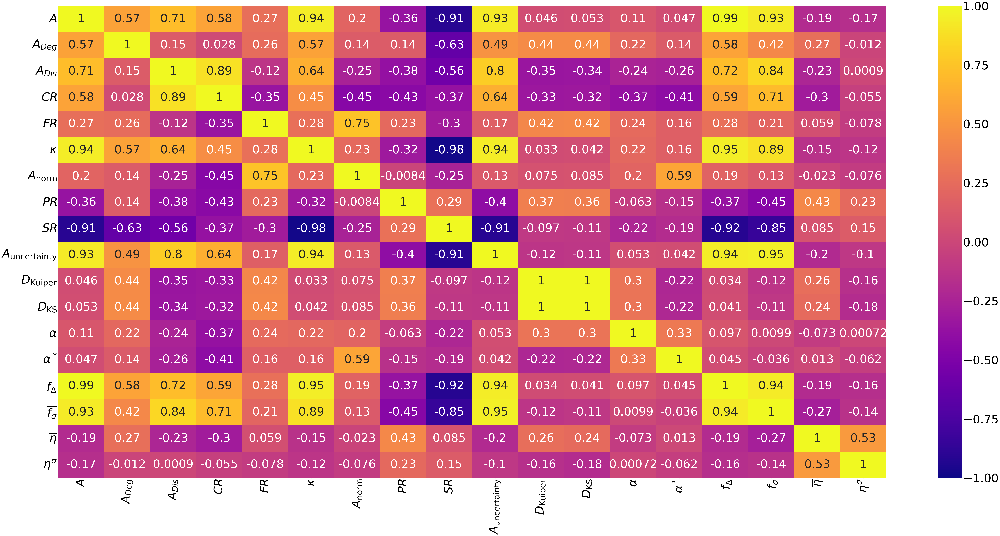

In [18]:
result_lists_over_versions_copy = result_lists_over_versions.copy()
plt.rcParams.update({"font.size": 60})
all_metric_results = {}
for task, metrics_dict in result_lists_over_versions_copy.items():
    if task == "photo_pce_10":
        continue
    for metric, metric_values in metrics_dict["Cumulative best"].items():
        if metric == "Metrics":
            continue
        if metric not in all_metric_results:
            all_metric_results[metric] = []
        all_metric_results[metric].extend(metric_values)

all_df = pd.DataFrame.from_dict(all_metric_results)

excluded_metrics = [
    "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$",
    "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$",
    "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$",
    "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$",
    "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$",
    "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$",
    "PointsBetterRandomRatio $\\overline{\\rho_{BRR}}$",
    "Recall $RC$",
]


all_df = all_df.drop(columns=excluded_metrics)
metric_mapping = {metric: metric[metric.find("$"):] for i, metric in enumerate(all_df.columns)}
all_df_renamed = all_df.rename(columns=metric_mapping, index=metric_mapping)

spearman_corr_all_df = all_df_renamed.corr(method=kendall)
fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(80, 40))


sns.heatmap(
    spearman_corr_all_df,
    annot=True,
    cmap="plasma",
    center=0,
    ax=axes,
    vmin=-1,
    vmax=1,
)

legend_text = "".join(
    [
        f"{v}: {k} -- " if v not in ("M5", "M9", "M25") else f"{v}: {k}\n"
        for i, (k, v) in enumerate(metric_mapping.items())
    ]
)
legend_text = legend_text[:-4]
# plt.figtext(
#     0.45,
#     -0.05,
#     legend_text,
#     ha="center",
#     fontsize=60,
#     bbox={"facecolor": "white", "alpha": 0.5, "pad": 20},
#     horizontalalignment="center",
#     verticalalignment="center",
#     transform=plt.gcf().transFigure,
# )
plt.tight_layout()
plt.savefig(
    "correlation_heatmap_all_tasks_permutated.svg",
    format="svg",
    dpi=300,
    bbox_inches="tight",
)

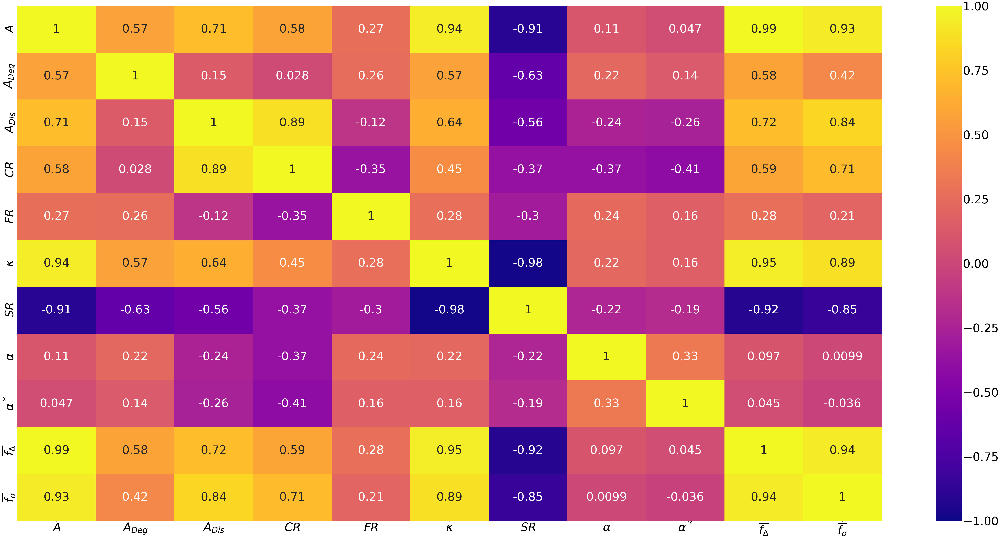

In [19]:
result_lists_over_versions_copy = result_lists_over_versions.copy()
plt.rcParams.update({"font.size": 60})
all_metric_results = {}
for task, metrics_dict in result_lists_over_versions_copy.items():
    if task == "photo_pce_10":
        continue
    for metric, metric_values in metrics_dict["Cumulative best"].items():
        if metric == "Metrics":
            continue
        if metric not in all_metric_results:
            all_metric_results[metric] = []
        all_metric_results[metric].extend(metric_values)

all_df = pd.DataFrame.from_dict(all_metric_results)

excluded_metrics = [
    "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$",
    "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$",
    "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$",
    "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$",
    "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$",
    "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$",
    "PointsBetterRandomRatio $\\overline{\\rho_{BRR}}$",
    "Recall $RC$",
    "KuiperMetric $D_{\\text{Kuiper}}$",
    "KolmogorovSmirnovMetric $D_{\\text{KS}}$",
    "NormalizedAreaUnderTheCurve $A_{\\text{norm}}$",
    "Point Position Score $\\overline{\\eta}$",
    "Precision $PR$",
    "Variance Point Score $\\eta^{\\sigma}$",
        "UncertaintyCurveArea $A_{\\text{uncertainty}}$"
]


all_df = all_df.drop(columns=excluded_metrics)
metric_mapping = {metric: metric[metric.find("$"):] for i, metric in enumerate(all_df.columns)}
all_df_renamed = all_df.rename(columns=metric_mapping, index=metric_mapping)

spearman_corr_all_df = all_df_renamed.corr(method=kendall)
fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(80, 40))


sns.heatmap(
    spearman_corr_all_df,
    annot=True,
    cmap="plasma",
    center=0,
    ax=axes,
    vmin=-1,
    vmax=1,
)

legend_text = "".join(
    [
        f"{v}: {k} -- " if v not in ("M5", "M9", "M25") else f"{v}: {k}\n"
        for i, (k, v) in enumerate(metric_mapping.items())
    ]
)
legend_text = legend_text[:-4]
# plt.figtext(
#     0.45,
#     -0.05,
#     legend_text,
#     ha="center",
#     fontsize=60,
#     bbox={"facecolor": "white", "alpha": 0.5, "pad": 20},
#     horizontalalignment="center",
#     verticalalignment="center",
#     transform=plt.gcf().transFigure,
# )
plt.tight_layout()
plt.savefig(
    "correlation_heatmap_all_tasks_permutated_small.svg",
    format="svg",
    dpi=300,
    bbox_inches="tight",
)

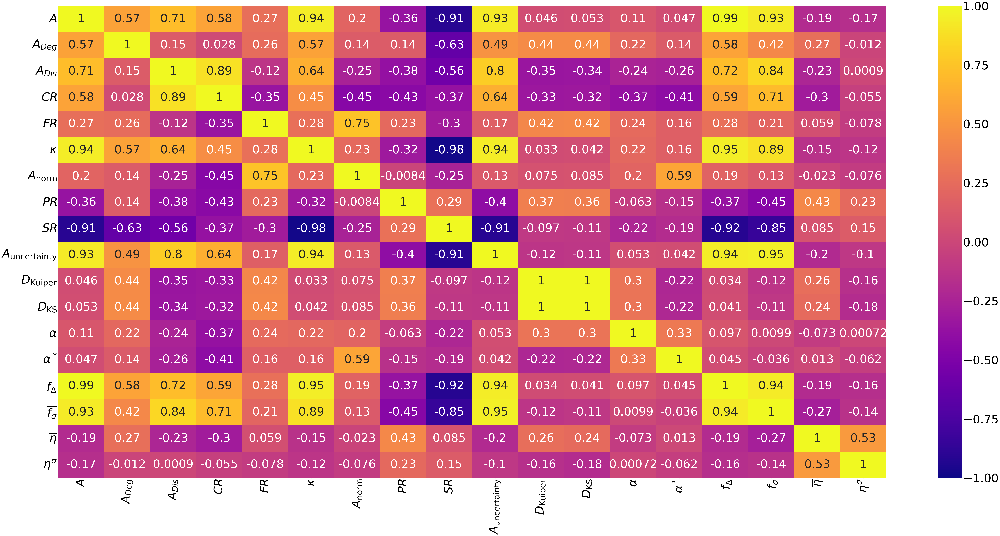

In [20]:
result_lists_over_versions_copy = result_lists_over_versions.copy()
plt.rcParams.update({"font.size": 60})
all_metric_results = {}
for task, metrics_dict in result_lists_over_versions_copy.items():
    if task == "photo_pce_10":
        continue
    for metric, metric_values in metrics_dict["Cumulative best"].items():
        if metric == "Metrics":
            continue
        if metric not in all_metric_results:
            all_metric_results[metric] = []
        all_metric_results[metric].extend(metric_values)

all_df = pd.DataFrame.from_dict(all_metric_results)

excluded_metrics = [
    "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$",
    "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$",
    "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$",
    "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$",
    "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$",
    "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$",
    "PointsBetterRandomRatio $\\overline{\\rho_{BRR}}$",
    "Recall $RC$",
]


all_df = all_df.drop(columns=excluded_metrics)
metric_mapping = {metric: metric[metric.find("$"):] for i, metric in enumerate(all_df.columns)}
all_df_renamed = all_df.rename(columns=metric_mapping, index=metric_mapping)

spearman_corr_all_df = all_df_renamed.corr(method=kendall)
fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(80, 40))


sns.heatmap(
    spearman_corr_all_df,
    annot=True,
    cmap="plasma",
    center=0,
    ax=axes,
    vmin=-1,
    vmax=1,
)

legend_text = "".join(
    [
        f"{v}: {k} -- " if v not in ("M6", "M11", "M25") else f"{v}: {k}\n"
        for i, (k, v) in enumerate(metric_mapping.items())
    ]
)
legend_text = legend_text[:-4]
# plt.figtext(
#     0.45,
#     -0.05,
#     legend_text,
#     ha="center",
#     fontsize=45,
#     bbox={"facecolor": "white", "alpha": 0.5, "pad": 20},
#     horizontalalignment="center",
#     verticalalignment="center",
#     transform=plt.gcf().transFigure,
# )
plt.tight_layout()
plt.savefig(
    "correlation_heatmap_all_tasks.svg", format="svg", dpi=300, bbox_inches="tight"
)

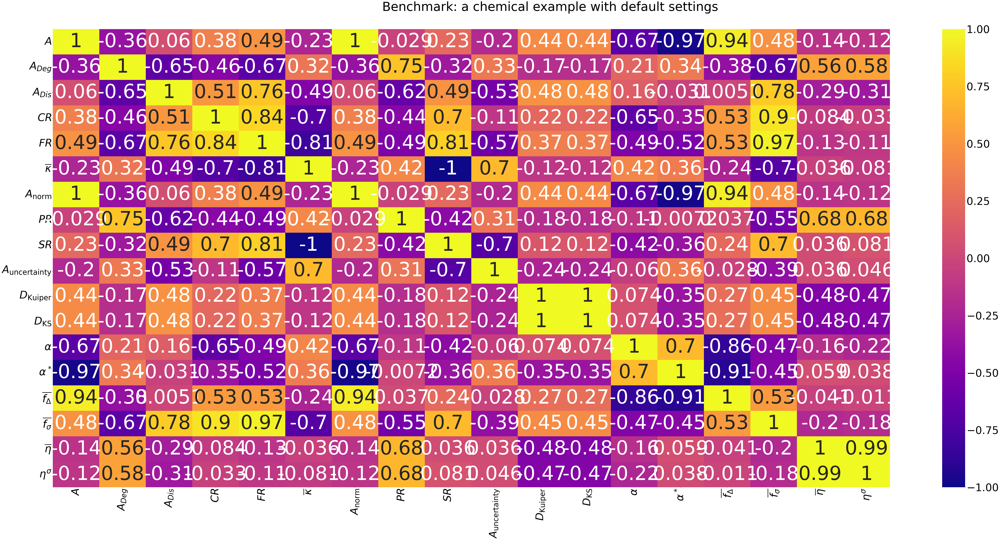

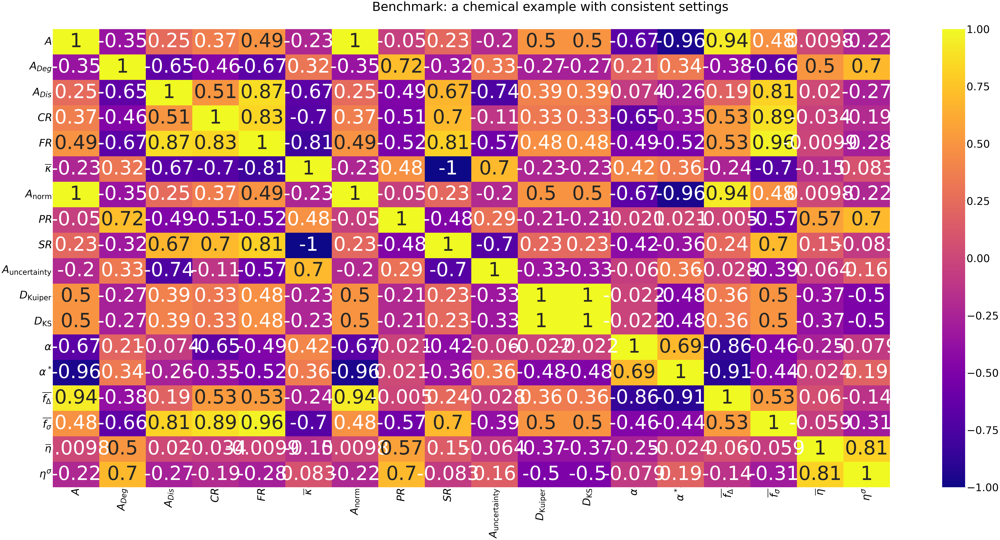

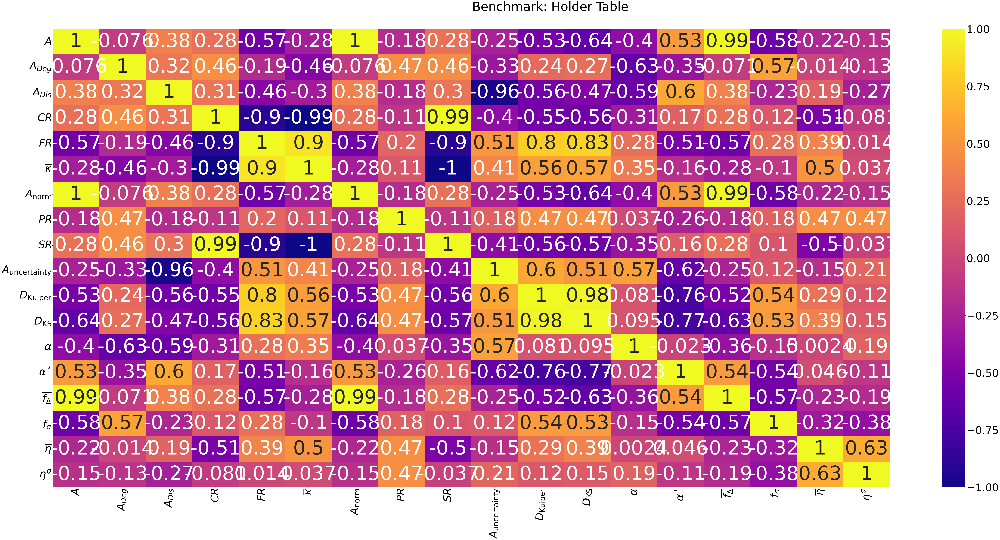

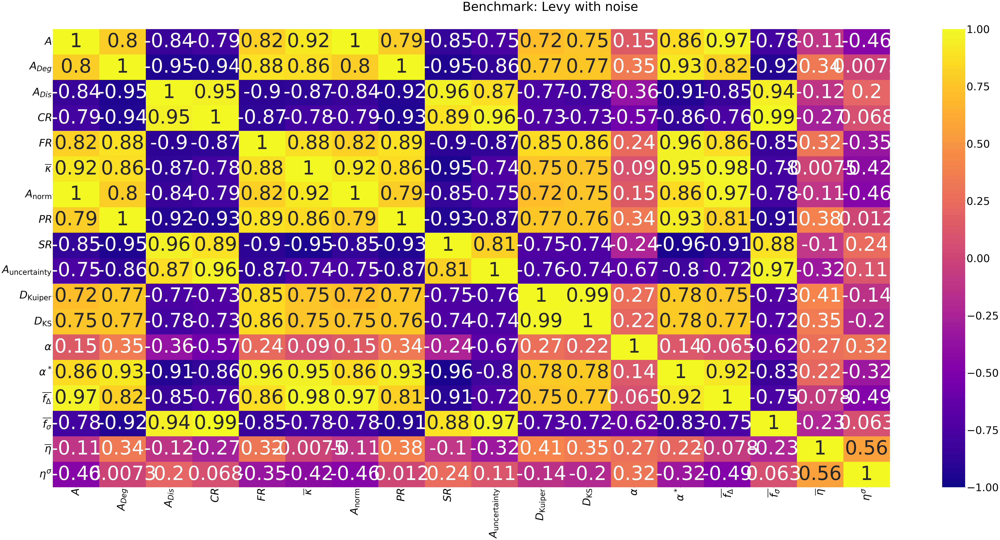

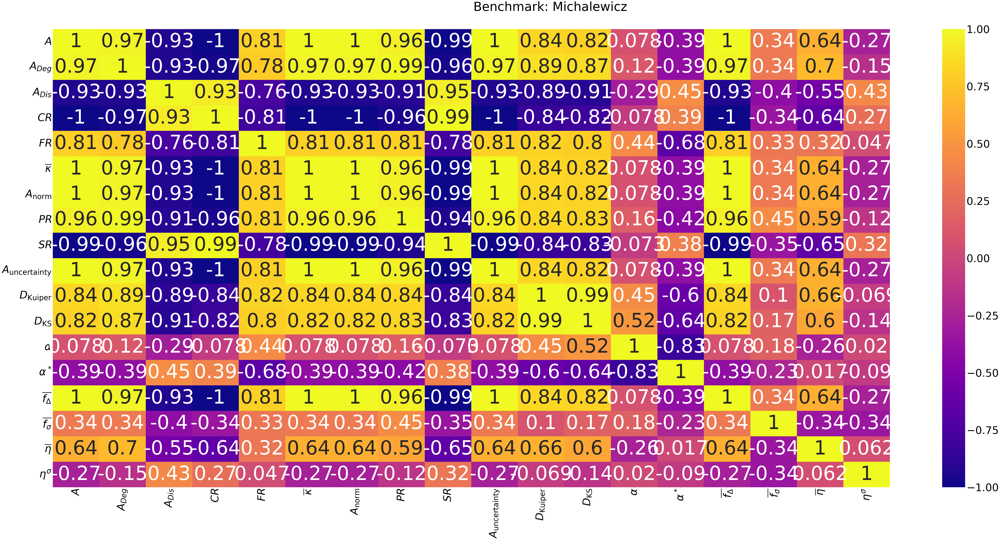

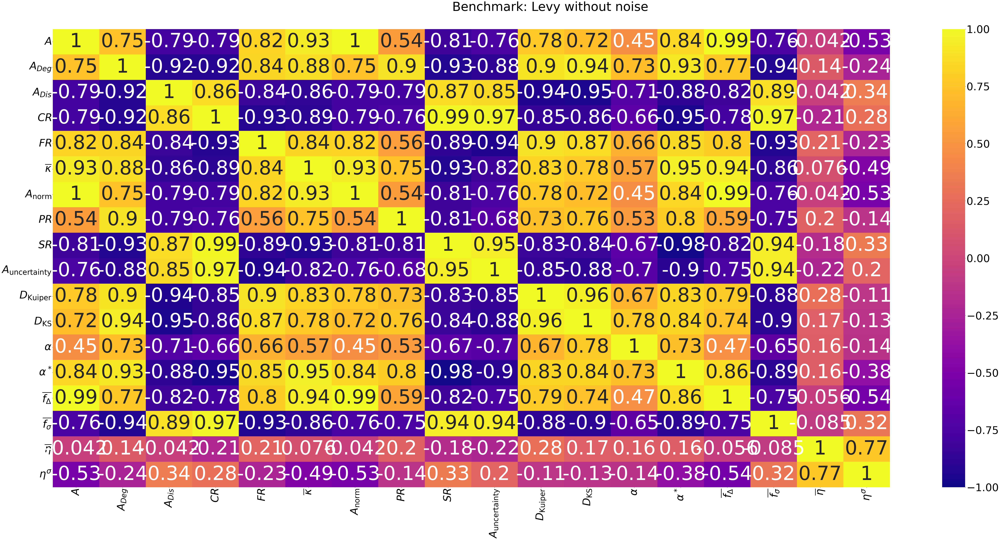

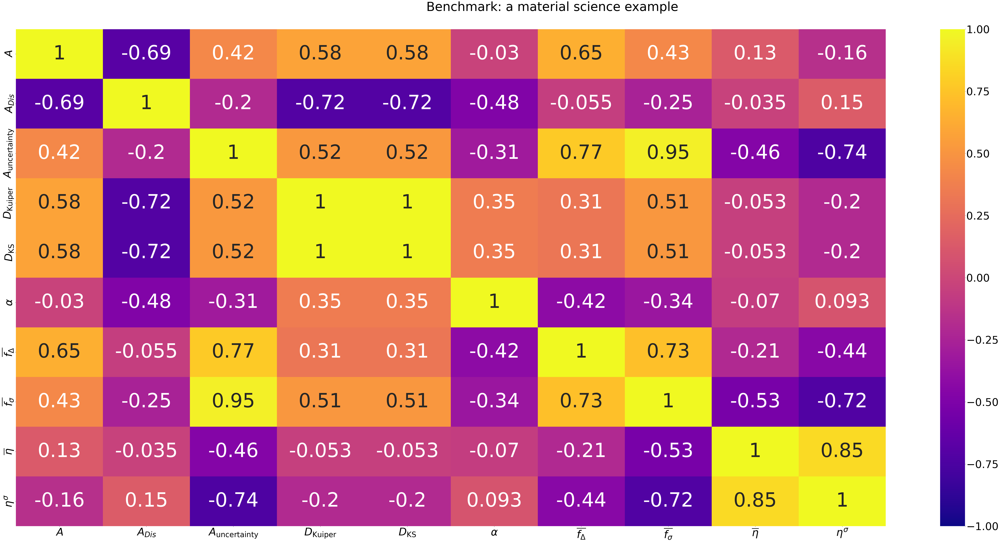

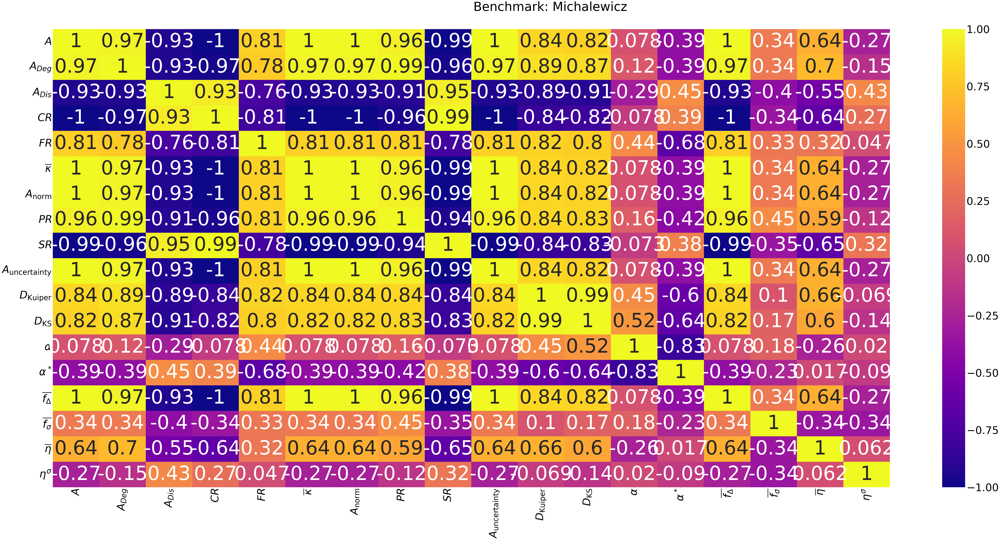

In [21]:
result_lists_over_versions_copy = result_lists_over_versions.copy()
plt.rcParams.update({"font.size": 54})
for task, metrics_dict in result_lists_over_versions_copy.items():
    df_cumbest = pd.DataFrame.from_dict(metrics_dict["Cumulative best"])
    df_iter = pd.DataFrame.from_dict(metrics_dict["Iterative best"])

    excluded_metrics = [
       "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$",
    "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$",
    "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$",
    "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$",
    "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$",
    "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$",
    "PointsBetterRandomRatio $\\overline{\\rho_{BRR}}$",

    ]

    if task != "photo_pce_10":
        excluded_metrics.append("Recall $RC$")

    df_cumbest = df_cumbest.drop(columns=excluded_metrics)
    df_cumbest = df_cumbest.drop(columns=["Metrics"])
    df_iter = df_iter.drop(columns=["Metrics"])

    # Create a heatmap with numbered labels
    metric_mapping = {metric: metric[metric.find("$"):] for i, metric in enumerate(all_df.columns)}
    df_cumbest_renamed = df_cumbest.rename(columns=metric_mapping)
    df_iter_renamed = df_iter.rename(columns=metric_mapping)

    spearman_corr_cumbest = df_cumbest_renamed.corr(method=kendall)
    # spearman_corr_iter = df_iter_renamed.corr(method="spearman")

    fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(80, 40))
    sns.heatmap(
        spearman_corr_cumbest,
        annot=True,
        cmap="plasma",
        center=0,
        ax=axes,
        vmin=-1,
        vmax=1,
        annot_kws={"fontsize": 100},  # Increase the font size of the annotations
    )

    # Add legend
    legend_text = "".join(
        [
            f"{v}: {k} -- " if v not in ("M5", "M9", "M25") else f"{v}: {k}\n"
            for _, (k, v) in enumerate(metric_mapping.items())
        ]
    )
    legend_text = legend_text[:-4]
    # plt.figtext(
    #     0.45,
    #     -0.05,
    #     legend_text,
    #     ha="center",
    #     fontsize=45,
    #     bbox={"facecolor": "white", "alpha": 0.5, "pad": 20},
    #     horizontalalignment="center",
    #     verticalalignment="center",
    #     transform=plt.gcf().transFigure,
    # )
    plt.suptitle(f"Benchmark: {taskmap[task]}", fontsize=64)
    plt.tight_layout()
    plt.savefig(
        f"out/correlation_heatmap_{task}.svg",
        format="svg",
        dpi=300,
        bbox_inches="tight",
    )

KeyError: "['NormalizedAreaUnderTheCurve $A_{\\\\text{norm}}$', 'Precision $PR$'] not found in axis"

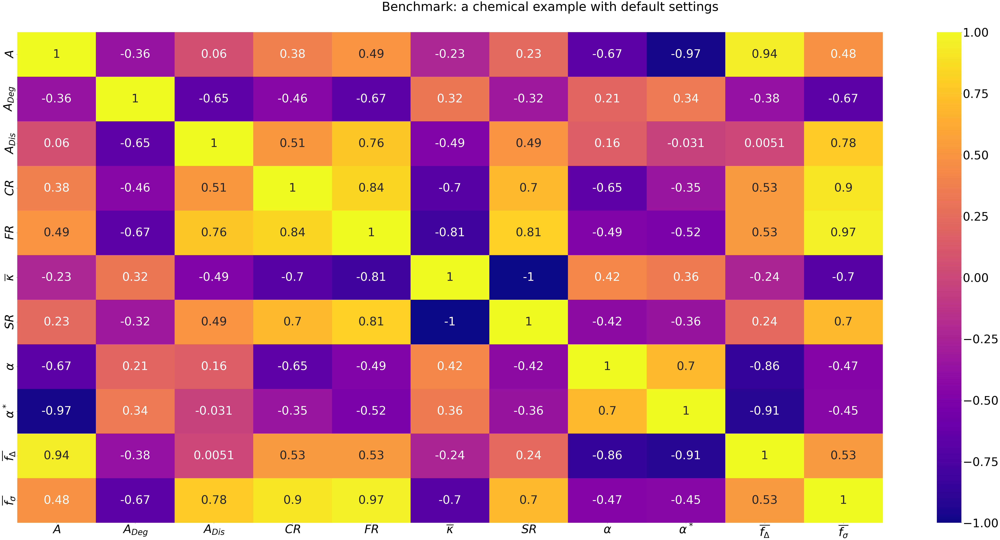

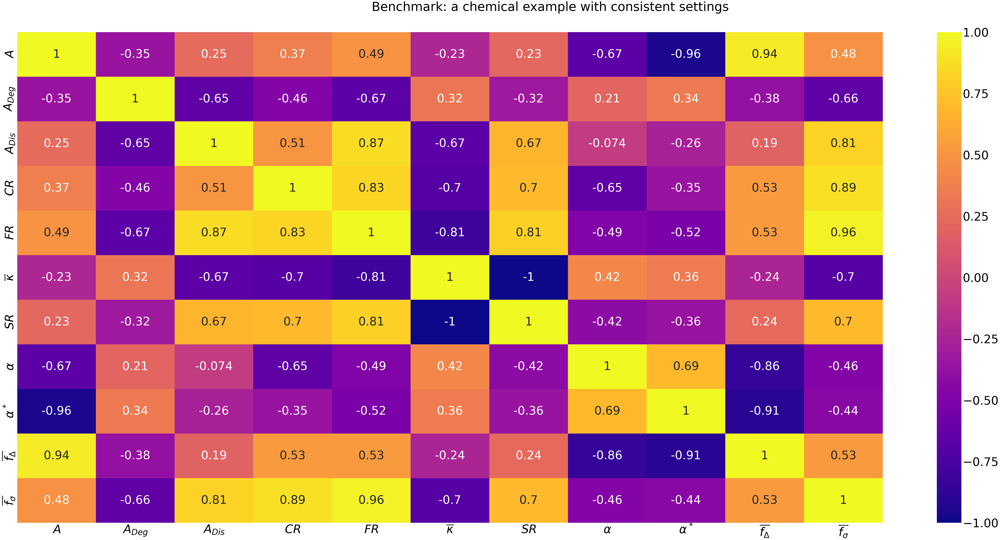

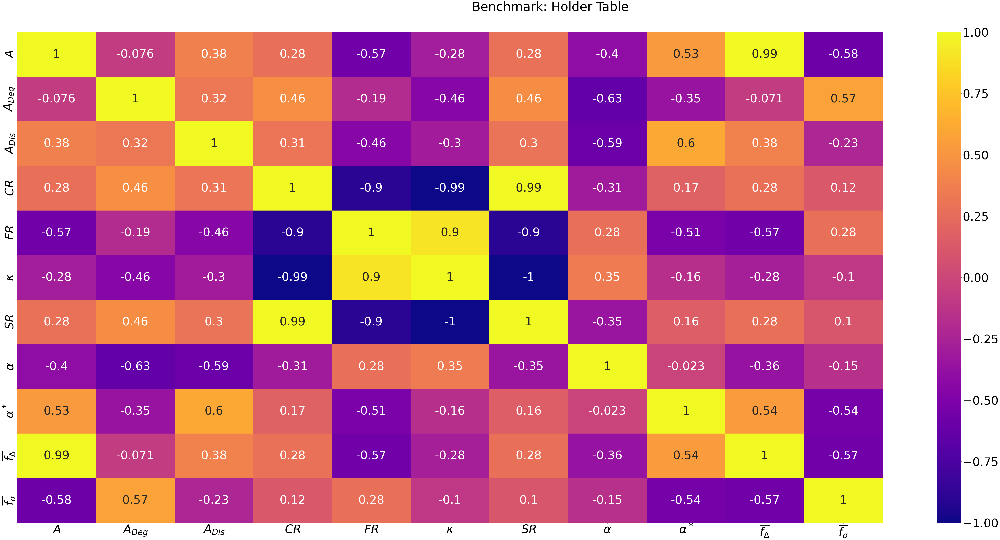

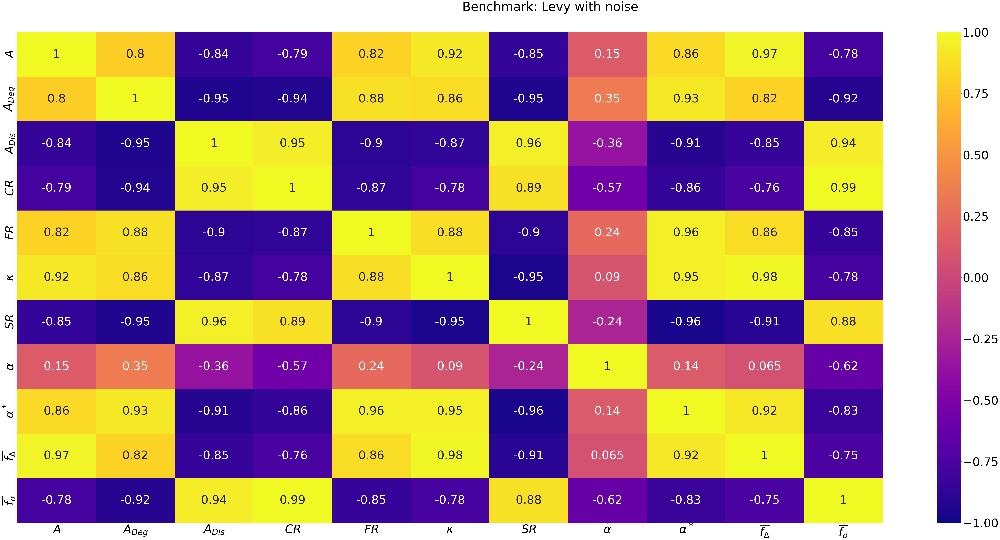

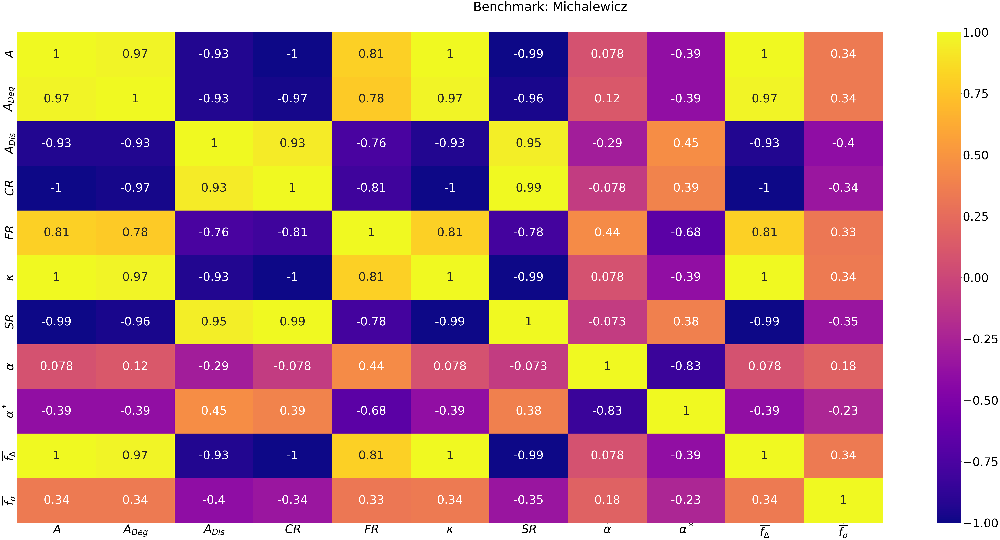

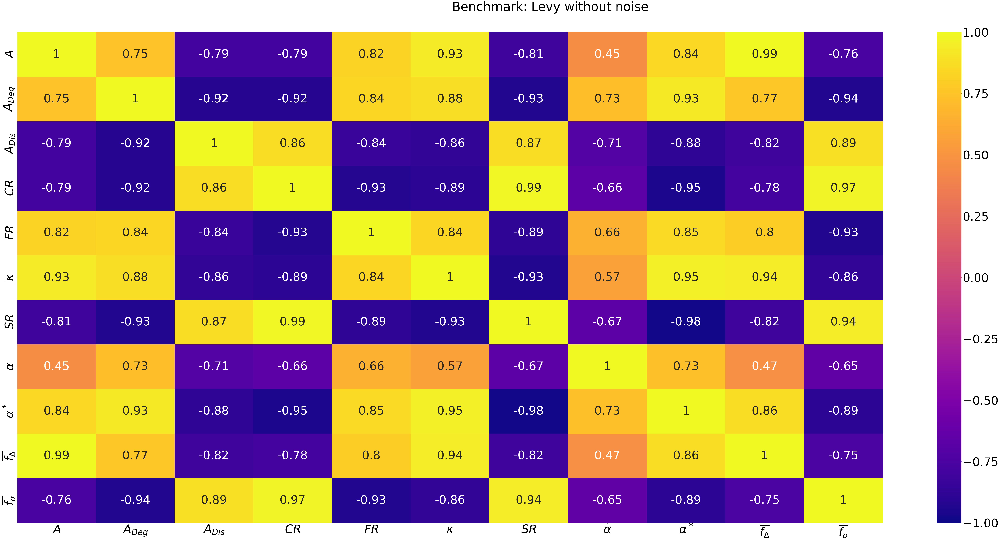

In [22]:
result_lists_over_versions_copy = result_lists_over_versions.copy()
plt.rcParams.update({"font.size": 60})
for task, metrics_dict in result_lists_over_versions_copy.items():
    df_cumbest = pd.DataFrame.from_dict(metrics_dict["Cumulative best"])
    df_iter = pd.DataFrame.from_dict(metrics_dict["Iterative best"])

    excluded_metrics = [
       "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$",
    "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$",
    "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$",
    "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$",
    "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$",
    "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$",
    "PointsBetterRandomRatio $\\overline{\\rho_{BRR}}$",
    "KuiperMetric $D_{\\text{Kuiper}}$",
    "KolmogorovSmirnovMetric $D_{\\text{KS}}$",
    "NormalizedAreaUnderTheCurve $A_{\\text{norm}}$",
    "Point Position Score $\\overline{\\eta}$",
    "Precision $PR$",
    "Variance Point Score $\\eta^{\\sigma}$",
        
    ]

    if task != "photo_pce_10":
        excluded_metrics.append("Recall $RC$")
        excluded_metrics.append("UncertaintyCurveArea $A_{\\text{uncertainty}}$")
        excluded_metrics.append("Recall $RC$")

    df_cumbest = df_cumbest.drop(columns=excluded_metrics)
    df_cumbest = df_cumbest.drop(columns=["Metrics"])
    df_iter = df_iter.drop(columns=["Metrics"])

    # Create a heatmap with numbered labels
    metric_mapping = {metric: metric[metric.find("$"):] for i, metric in enumerate(all_df.columns)}
    df_cumbest_renamed = df_cumbest.rename(columns=metric_mapping)
    df_iter_renamed = df_iter.rename(columns=metric_mapping)

    spearman_corr_cumbest = df_cumbest_renamed.corr(method=kendall)
    # spearman_corr_iter = df_iter_renamed.corr(method="spearman")

    fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(80, 40))
    sns.heatmap(
        spearman_corr_cumbest,
        annot=True,
        cmap="plasma",
        center=0,
        ax=axes,
        vmin=-1,
        vmax=1,
    )

    # Add legend
    legend_text = "".join(
        [
            f"{v}: {k} -- " if v not in ("M5", "M9", "M25") else f"{v}: {k}\n"
            for _, (k, v) in enumerate(metric_mapping.items())
        ]
    )
    legend_text = legend_text[:-4]
    # plt.figtext(
    #     0.45,
    #     -0.05,
    #     legend_text,
    #     ha="center",
    #     fontsize=45,
    #     bbox={"facecolor": "white", "alpha": 0.5, "pad": 20},
    #     horizontalalignment="center",
    #     verticalalignment="center",
    #     transform=plt.gcf().transFigure,
    # )
    plt.suptitle(f"Benchmark: {taskmap[task]}", fontsize=64)
    plt.tight_layout()
    plt.savefig(
        f"out/correlation_heatmap_{task}_small.svg",
        format="svg",
        dpi=300,
        bbox_inches="tight",
    )

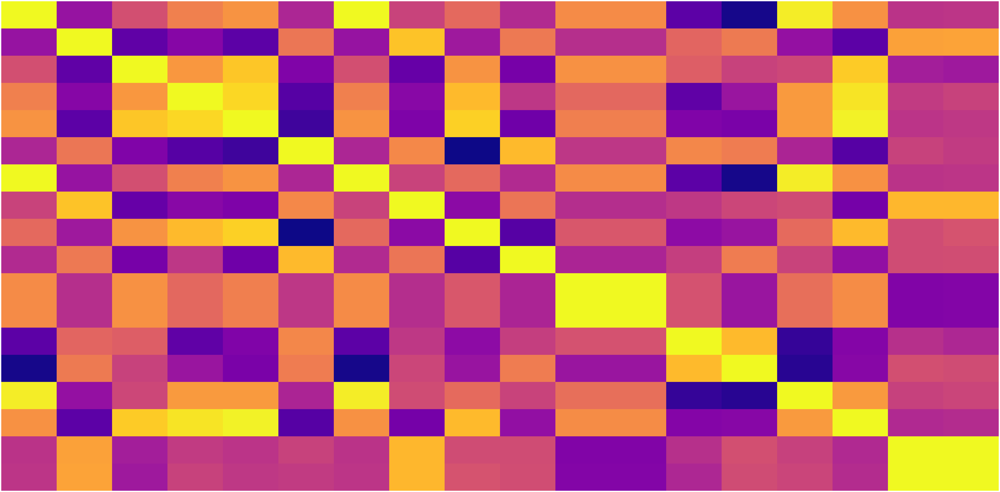

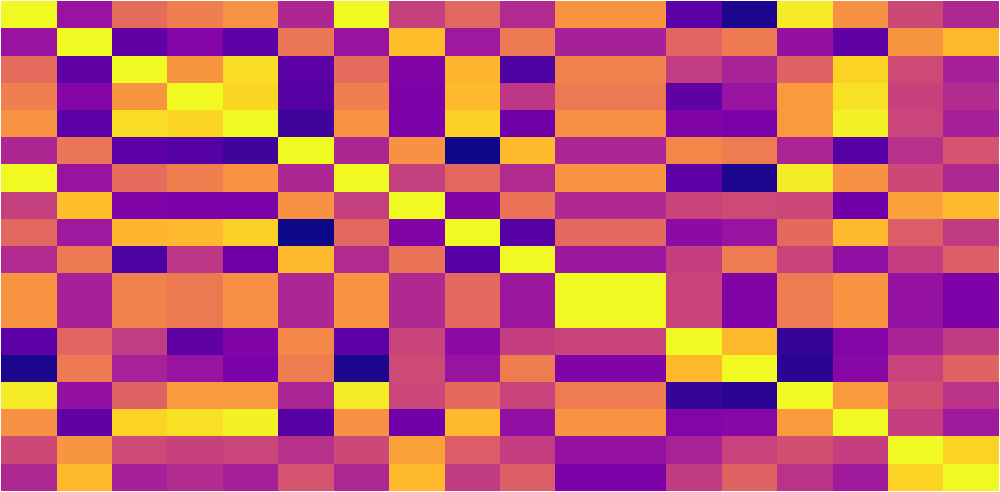

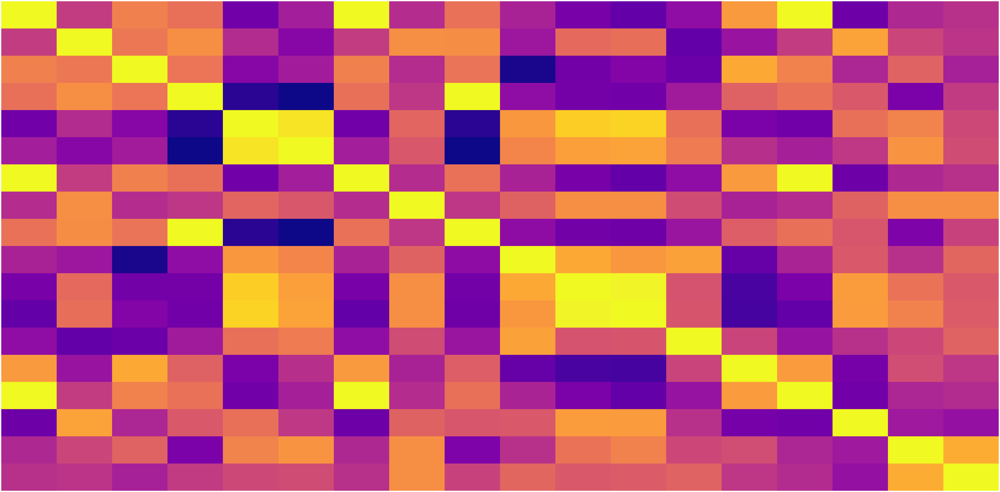

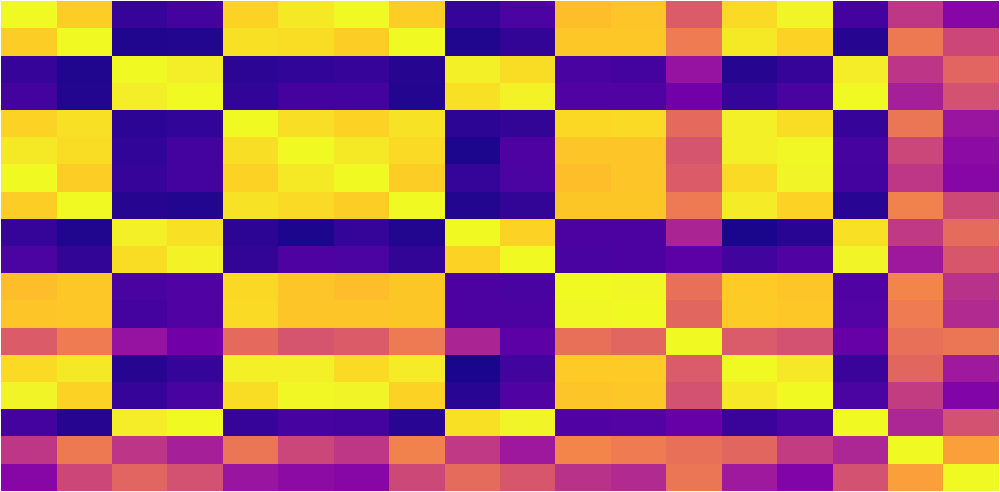

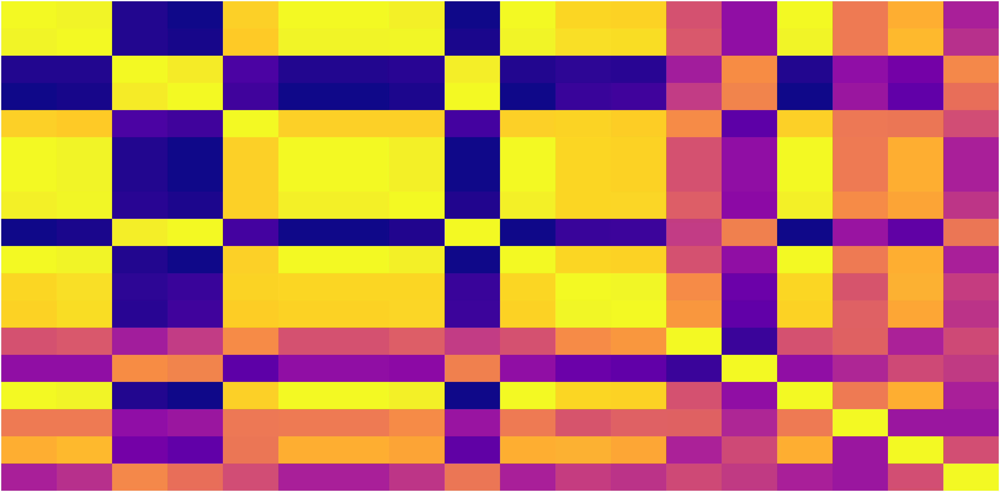

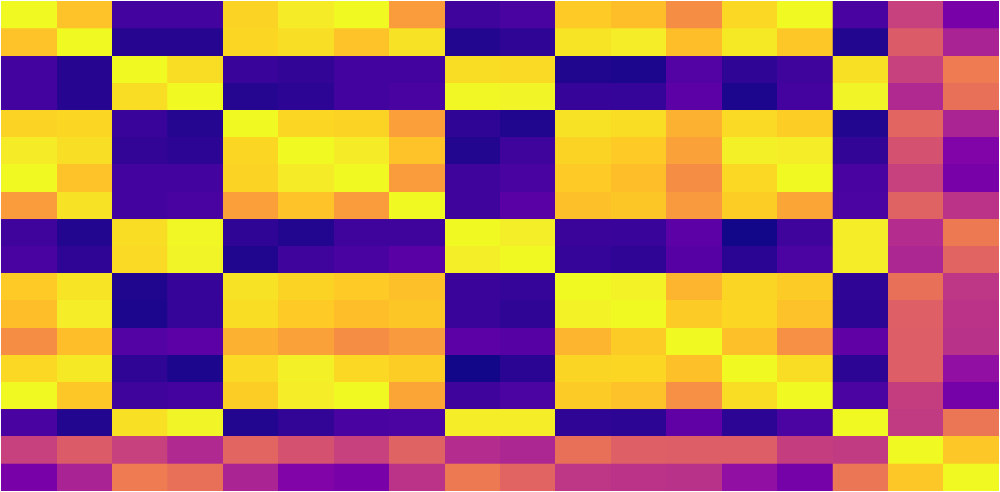

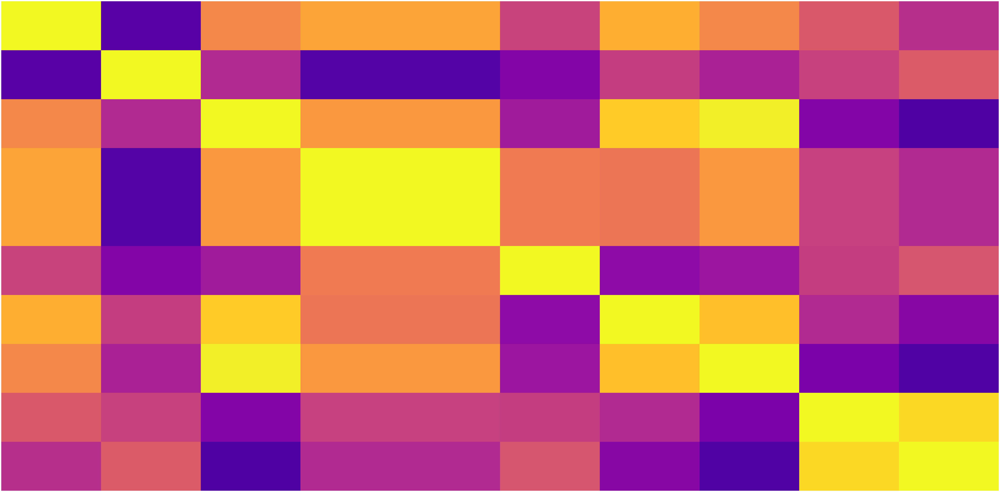

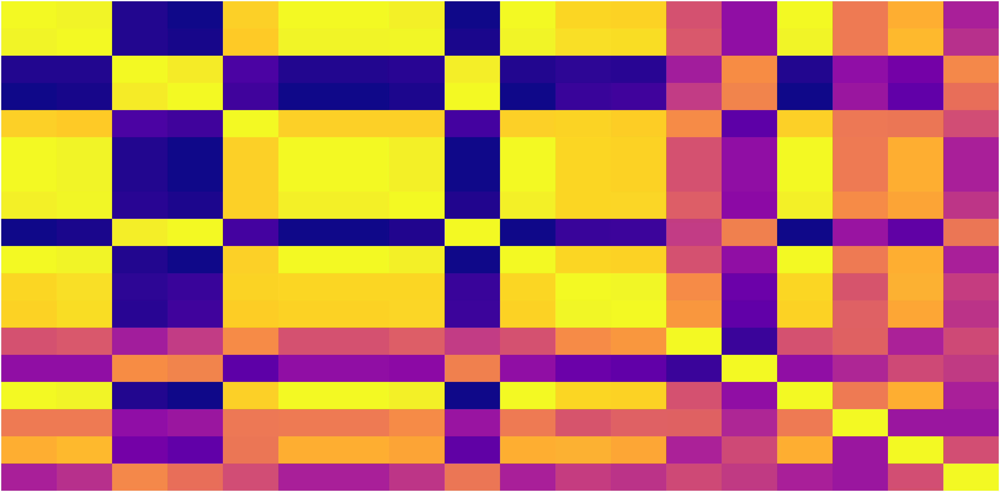

In [ ]:
result_lists_over_versions_copy = result_lists_over_versions.copy()
plt.rcParams.update({"font.size": 44})
for task, metrics_dict in result_lists_over_versions_copy.items():
    df_cumbest = pd.DataFrame.from_dict(metrics_dict["Cumulative best"])
    df_iter = pd.DataFrame.from_dict(metrics_dict["Iterative best"])

    excluded_metrics = [
       "PointsBetterPreviousRatio $\\overline{\\rho_{BPR}}$",
    "PointsWorsePreviousRatio $\\overline{\\rho_{WPR}}$",
    "PointsEqualPreviousRatio $\\overline{\\rho_{EPR}}$",
    "PointsVarianceEqualPreviousRatio $\\rho_{EPR}^{\\sigma}$",
    "PointsVarianceWorsePreviousRatio $\\rho_{WPR}^{\\sigma}$",
    "PointsVarianceBetterPreviousRatio $\\rho_{BPR}^{\\sigma}$",
    "PointsBetterRandomRatio $\\overline{\\rho_{BRR}}$",
    ]

    if task != "photo_pce_10":
        excluded_metrics.append("Recall $RC$")

    df_cumbest = df_cumbest.drop(columns=excluded_metrics)
    df_cumbest = df_cumbest.drop(columns=["Metrics"])
    df_iter = df_iter.drop(columns=["Metrics"])

    # Create a heatmap with numbered labels
    metric_mapping = {metric: metric[metric.find("$"):] for i, metric in enumerate(all_df.columns)}
    df_cumbest_renamed = df_cumbest.rename(columns=metric_mapping)
    df_iter_renamed = df_iter.rename(columns=metric_mapping)

    spearman_corr_cumbest = df_cumbest_renamed.corr(method=kendall)
    # spearman_corr_iter = df_iter_renamed.corr(method="spearman")

    fig, axes = plt.subplots(ncols=1, nrows=1, figsize=(80, 40))
    sns.heatmap(
        spearman_corr_cumbest,
        annot=False,
        cmap="plasma",
        center=0,
        ax=axes,
        vmin=-1,
        vmax=1,
        cbar=False, xticklabels=False, yticklabels=False
    )

    # Add legend

    plt.tight_layout()
    plt.savefig(
        f"out/correlation_heatmap_{task}__no_image.svg",
        format="svg",
        dpi=300,
        bbox_inches="tight",
    )